In [1]:
se_f = "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/allSamples.integrated.rds"
indir = "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples"
motif_outdir = "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/"
outdir = "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1/"
#n_donors = 2


min_pct = 0.01
logfc_thresh = 0.1
p_thresh = 0.1

use_latent_vars = FALSE
genome = "/data/Mito_Trace/data/external/GRCh38_MT_blacklist/fasta/genome.fa"
cores=16
utils_script <- "/data/Mito_Trace/R_scripts/seurat_utils.R"
#source("~/data/Projects/Mito_Trace/R_scripts/addPWM.R")


In [2]:
if (use_latent_vars){
    latent.vars = "peaks_depth"
}else{
    latent.vars=NULL
}

In [3]:
source(utils_script)
library("Nebulosa")
library(Seurat)
library(Signac)
library(ggplot2)
library(patchwork)
set.seed(1234)
library(magrittr)
library(cowplot)
library(metap)
library(dplyr)
library(future)
plan("multiprocess", workers = cores)
#options(future.globals.maxSize = 50000 * 1024^2) # for 50 Gb RAM
options(future.globals.maxSize = 8000 * 1024^2)
library("ComplexHeatmap")

Registered S3 method overwritten by 'spatstat.core':
  method          from
  formula.glmmPQL MASS

Attaching SeuratObject

Attaching sp

Warning message:
“package ‘dplyr’ was built under R version 4.1.3”

Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Loading required package: ggplot2

Warning message:
“package ‘ggplot2’ was built under R version 4.1.3”
Loading required package: patchwork

Warning message:
“package ‘magrittr’ was built under R version 4.1.3”

Attaching package: ‘cowplot’


The following object is masked from ‘package:patchwork’:

    align_plots


Warning message:
“package ‘future’ was built under R version 4.1.3”
Warning message:
“Strategy 'multiprocess' is deprecated in future (>= 1.20.0). Instead, explicitly specify either 'multisession' or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'.”


In [4]:
if (file.exists(file.path(motif_outdir, "se.chromvar.rds"))){
    print("Loading se with chromvar")
    se <- readRDS(file=file.path(motif_outdir, "se.chromvar.rds"))    
}else{
    print("Running chromvar")
    se_init = readRDS(se_f)

    se <- get.pwm(se_init, genome=genome)
    saveRDS(object=se, file=file.path(motif_outdir, "se.chromvar.rds"))     
}

[1] "Running chromvar"




Loading required package: BSgenome

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    dirname, do.call, duplicated, eval, evalq, Filter, Find, get, grep,
    grepl, intersect, is.unsorted, lapply, Map, mapply, match, mget,
    order, paste, pmax, pmax.int, pmin, pmin.int, Position, rank,
    rbind, Reduce, rownames, sapply, setdiff, sort, table, tapply,
    union, unique, unsplit, which.max, which.min


Loading required package: S4Vectors

Warning message:
“package ‘S4Vectors’ was built under R version 4.1.2”
Loading required package: stats4


Attaching package: ‘S4Vectors’


The following object is masked from ‘package:future’:

    values


The foll

In [5]:
se

An object of class Seurat 
224000 features across 30062 samples within 4 assays 
Active assay: chromvarnames (633 features, 0 variable features)
 3 other assays present: ATAC, RNA, chromvar
 2 dimensional reductions calculated: integrated_lsi, umap

In [6]:
se[[]]

,orig.ident,nCount_ATAC,nFeature_ATAC,total,duplicate,chimeric,unmapped,lowmapq,mitochondrial,passed_filters,⋯,TSS.percentile,pct_reads_in_peaks,blacklist_ratio,high.tss,nucleosome_group,ATAC_snn_res.0.8,seurat_clusters,nCount_ATAC_log2,nCount_RNA,nFeature_RNA
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<fct>,<fct>,<dbl>,<dbl>,<int>
cd34norm_Flt3l_AAACGAAAGAGCTCCC-1,Flt3l,5127,5127,25798,3956,111,95,1643,4740,15253,⋯,0.46,30.59726,0,High,NS < 4,11,11,12.32418,8908,5567
cd34norm_Flt3l_AAACGAAAGCGATACG-1,Flt3l,2309,2309,18340,2478,78,92,794,9325,5573,⋯,0.62,38.07644,0,High,NS < 4,2,2,11.17368,3006,2472
cd34norm_Flt3l_AAACGAAAGGCTTCGC-1,Flt3l,4232,4232,28417,4398,132,122,1771,10224,11770,⋯,0.30,32.71878,0,High,NS < 4,6,6,12.04746,6521,4620
cd34norm_Flt3l_AAACGAAAGTACAACA-1,Flt3l,1510,1510,12018,1524,60,45,585,5688,4116,⋯,0.06,32.28863,0,High,NS < 4,11,11,10.56129,2356,1996
cd34norm_Flt3l_AAACGAACAACGTACT-1,Flt3l,3199,3199,37690,3034,82,125,1680,24974,7795,⋯,0.69,37.78063,0,High,NS < 4,6,6,11.64386,4275,3340
cd34norm_Flt3l_AAACGAACAAGCGGTA-1,Flt3l,1463,1463,9381,1416,44,50,547,3616,3708,⋯,0.22,34.49299,0,High,NS < 4,2,2,10.51570,2150,1864
cd34norm_Flt3l_AAACGAACACCTGGTG-1,Flt3l,3053,3053,30421,5698,112,157,1762,14034,8658,⋯,0.63,31.17348,0,High,NS < 4,7,7,11.57648,5338,3881
cd34norm_Flt3l_AAACGAACACGATATC-1,Flt3l,2575,2575,15245,1960,89,32,737,5330,7097,⋯,0.11,32.04171,0,High,NS < 4,4,4,11.33092,4225,3237
cd34norm_Flt3l_AAACGAACACTTACAG-1,Flt3l,10684,10684,48515,10680,240,158,2715,12096,22626,⋯,0.36,47.67966,0,High,NS < 4,14,14,13.38330,13471,7325


## Import seurat object and clones

## Run DE

In [7]:
cluster.ids <- sort(unique(se$seurat_clusters))
Idents(se) <- se$seurat_clusters

In [8]:
cluster.ids

[1] 0  1  2  3  4  5  6  7  8  9  10 11 12 13 14 15 16
Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16

In [9]:
all.pvals <- data.frame(matrix(nrow=dim(se)[1],ncol=0),
                          row.names=row.names(se))
#all.top.sig <- c()
for (id.1 in cluster.ids){ #or however many clusters you have
    print("id.1")
    DefaultAssay(se) <- "chromvarnames"

    try({     
        da <- FindMarkers(
          object = se,
          ident.1 = id.1,
          only.pos = FALSE,
          mean.fxn = rowMeans,
          logfc.threshold = logfc_thresh,
          min.pct = min_pct,
          #latent.vars=latent.vars,
          fc.name = "avg_diff")
        
        da$p_val_adj_BH <- stats::p.adjust(da$p_val, method = "BH", n = length(da$p_val))
        write.csv(da, file=file.path(outdir, paste0("cluster",id.1,".DE.csv")), quote=F)
        
        gally <- GGally::ggpairs(da[,c("p_val", "p_val_adj", "avg_diff", "p_val_adj_BH" )], aes(alpha = 0.4))
        ggsave(plot=gally, file=file.path(outdir, paste0("cluster",id.1,".DE.TF.pvalHist.png")))
        
        # Save motifs
        DefaultAssay(se) <- "ATAC"
        raw.ids <- names(Motifs(se)@motif.names)
        print(head(rownames(da)))
        rownames(da) <- sapply((rownames(da)), function(x){raw.ids[match(x, Motifs(se)@motif.names)]})
        m <- MotifPlot(
          object = se,
          motifs = head(rownames(da)),
          assay = 'ATAC'
        )
        ggsave(plot=m, file=file.path(outdir, paste0("cluster",id.1,".DE.TF.motif.top.png")))
        write.csv(da, file=file.path(outdir, paste0("cluster", id.1,".motifs.DE.csv")), quote=F)
    })
}


[1] "id.1"


Registered S3 method overwritten by 'GGally':
  method from   
  +.gg   ggplot2

Saving 6.67 x 6.67 in image



[1] "CTCF"        "NR4A2"       "FOS"         "JUN"         "JUND(var.2)"
[6] "MEF2C"      


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "CTCF"       "FOS"        "FOSL2"      "JUN(var.2)" "MAF::NFE2" 
[6] "NRF1"      


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "KLF15" "KLF2"  "SP9"   "SP3"   "KLF11" "KLF5" 


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "CEBPB"        "CEBPE"        "CEBPG"        "CEBPG(var.2)" "ATF4"        
[6] "CEBPA"       


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "GATA2" "GATA3" "GATA5" "GATA4" "GATA6" "GATA1"


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "STAT1::STAT2" "IRF1"         "GATA1::TAL1"  "IRF8"         "IRF9"        
[6] "GATA2"       


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "GATA1::TAL1" "GATA2"       "GATA3"       "IKZF1"       "GATA5"      
[6] "GATA1"      


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "GATA1::TAL1" "KLF5"        "ELF5"        "ETV6"        "SP4"        
[6] "SPIC"       


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "CEBPD"        "CEBPA"        "ATF4"         "HLF"          "CEBPG(var.2)"
[6] "CEBPB"       


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "IRF2"       "PAX6"       "TAL1::TCF3" "FOS"        "FOSL2"     
[6] "JUN(var.2)"


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "STAT1::STAT2" "IRF1"         "ELF5"         "ETV6"         "SPIC"        
[6] "ZKSCAN5"     


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "ZNF135"       "CEBPG(var.2)" "ATF4"         "CEBPA"        "CEBPD"       
[6] "NR2F1"       


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "GATA1::TAL1" "ELF5"        "ETV6"        "SPIC"        "CEBPB"      
[6] "CEBPE"      


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "ETV4"                "NFIB"                "NFIC::TLX1"         
[4] "SMAD2::SMAD3::SMAD4" "ETV1"                "GABPA"              


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "FOS"       "FOSL2"     "BATF::JUN" "FOS::JUND" "BATF"      "FOS::JUNB"


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "RUNX2"        "CEBPD"        "CEBPG(var.2)" "CEBPB"        "CEBPE"       
[6] "CEBPA"       


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



[1] "id.1"


Saving 6.67 x 6.67 in image



[1] "E2F6"          "TFAP2B(var.3)" "TFAP2B(var.2)" "TFAP2A(var.3)"
[5] "TFAP2C(var.3)" "TFAP2E"       


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Saving 6.67 x 6.67 in image



In [10]:
n_top_genes = 3

top.sig <- c()
names.sig <- c()

all.pvals <- data.frame(matrix(nrow=dim(se)[1],ncol=0),
                          row.names=row.names(se))

for (id.1 in cluster.ids){ #or however many clusters you have
    try({
        print("id.1")
        print(id.1)
        DefaultAssay(se) <- "chromvarnames"
        #curr.tf.da <- read.csv(da, file=file.path(outdir, paste0("cluster", id.1,".motifs.DE.csv")), quote=F)
        curr.tf.da <- read.csv(file.path(outdir, paste0("cluster", id.1,".DE.csv"))) %>% arrange(p_val)    
        
        print(head(curr.tf.da))
        row.names(curr.tf.da) <- curr.tf.da$X 

        top.sig <- c(top.sig, head(row.names(curr.tf.da), n_top_genes))
        #all.top.sig <- c(all.top.sig, head(row.names(curr.tf.da), n_top_genes))
        
        all.pvals[row.names(curr.tf.da), id.1] <- curr.tf.da$p_val_adj_BH
        curr.sig <- curr.tf.da %>% dplyr::filter(p_val_adj_BH<p_thresh)
        names.sig <- c(names.sig, row.names(curr.sig))        
        #all.da <- all.da
    })
}


[1] "id.1"
[1] "0"
            X p_val   avg_diff pct.1 pct.2 p_val_adj p_val_adj_BH
1        CTCF     0  0.7505594 0.686 0.450         0            0
2       NR4A2     0 -0.8239350 0.247 0.559         0            0
3         FOS     0 -1.2270364 0.291 0.537         0            0
4         JUN     0 -1.0793636 0.204 0.568         0            0
5 JUND(var.2)     0 -0.6215904 0.298 0.539         0            0
6       MEF2C     0 -0.5179531 0.283 0.532         0            0
[1] "id.1"
[1] "1"
           X p_val   avg_diff pct.1 pct.2 p_val_adj p_val_adj_BH
1       CTCF     0 -1.2639771 0.112 0.538         0            0
2        FOS     0  2.0821532 0.909 0.443         0            0
3      FOSL2     0  2.1140637 0.905 0.453         0            0
4 JUN(var.2)     0  1.9430490 0.898 0.443         0            0
5  MAF::NFE2     0  0.9191722 0.800 0.491         0            0
6       NRF1     0 -1.0612093 0.163 0.470         0            0
[1] "id.1"
[1] "2"
      X         p_val   av

In [11]:
print(length(unique(names.sig)))

[1] 633


In [12]:
print(length(unique(top.sig)))

[1] 35


### save de results summarized for each cluster

In [13]:
write.csv(all.pvals, file.path(outdir, "clusters.DE.bh.pvals.csv"))

In [14]:
### Plot density
options(repr.plot.width = 8, repr.plot.height = 8, repr.plot.res = 300)
plot_tf <- function(name.sig){
    print(name.sig)
    f <- plot_density(se, name.sig) + ggtitle(name.sig)
    ggsave(plot=f,
       file=file.path(outdir, paste0("density.", name.sig,".embedFeat.top.png")))
    #f <- plot_density(se, name.sig) + ggtitle(name.sig)
    
    f2  <- FeaturePlot(
          object = se,
          features = name.sig,
          min.cutoff = 'q10',
          max.cutoff = 'q90',
          pt.size = 0.1
        )
    ggsave(plot=f2,
       file=file.path(outdir, paste0(name.sig,".embedFeat.top.pdf")))
}

sapply(unique(names.sig), plot_tf)

[1] "CTCF"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR4A2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOS"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "JUN"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "JUND(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MEF2C"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ELK4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "YY1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SREBF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SREBF2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ELF4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ELF5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ETV6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FLI1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MEF2B"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SPIC"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ESR1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ESRRB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR2F1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RARA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HIC2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF143"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ELK3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ERF"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ETS1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ETV3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FEV"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MEF2D"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HES5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HES7"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CEBPB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CEBPE"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CEBPG"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFE2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TP53"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TP73"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MYB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR2F2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PBX3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOS::JUN"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL1::JUN"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL2::JUN"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "JUN::JUNB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL2::JUNB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ELF2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ETS2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MAZ"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR1D1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR1D2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR2C1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR2C2(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR2F1(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR5A1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PITX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RARB(var.3)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RARG(var.3)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RXRB(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RXRG(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "THAP11"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "THRB(var.3)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZBTB6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF135"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF140"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF460"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CEBPG(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MEIS1(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MEIS2(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZFP42"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZKSCAN5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ATF4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CEBPA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CEBPD"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CTCFL"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EHF"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ELF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ELF3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ESRRA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ETV5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HLF"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "JUND"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MAFK"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MEF2A"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFIL3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFYB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PBX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PKNOX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SPIB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SREBF1(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP2C(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "USF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "USF2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SPI1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "JDP2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "E2F2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL2::JUND"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RHOXF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOS::JUND"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZBTB14"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ESR2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSB::JUNB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOS::JUNB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL1::JUNB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFKB1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RXRG"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BATF::JUN"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BATF"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "JUNB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF15"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BATF3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ELK1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BACH2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ERG"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL1::JUND"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HINFP"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HNF4A(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NRF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CDX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TCFL5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EGR1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SMAD2::SMAD3::SMAD4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR6A1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR2F1(var.3)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF354C"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR1H2::RXRA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZBTB7A"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CDX4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFEB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TEF"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "JUN(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXD9"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBX18"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PITX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF148"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RARA::RXRA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "THRB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TEAD2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PITX3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HAND2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RARA(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "REL"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TP63"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RELA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU4F3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBX6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ATF2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU4F1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NKX6-1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZBTB12"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR4A2::RXRA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBX3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFKB2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RXRB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GABPA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "OTX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR2F6(var.3)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MNX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR1H4::RXRA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFDP1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BACH1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EGR3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PHOX2B"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF740"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "YY2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GATA1::TAL1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXC13"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RARA::RXRG"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MGA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBX15"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "REST"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RXRA::VDR"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SNAI2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXA4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PAX9"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PPARD"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SRF"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MAF::NFE2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "VEZF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HES6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RORB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZFP57"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "DBP"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFIC::TLX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU4F2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MXI1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NKX2-2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF382"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RFX5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBX4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBX5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PPARA::RXRA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ARGFX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZIC5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MITF"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ETV1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF17"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR1I2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXA10"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NKX2-5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SRY"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MYOG"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZBTB33"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EGR2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXD11"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFE3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CDX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NEUROG2(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RFX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TEAD1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GSC"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXB9"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "IRF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BHLHE41"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXC10"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PPARG"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SP2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EGR4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MAX::MYC"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TGIF2LX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RUNX3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TAL1::TCF3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFE2L1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GSC2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TGIF2LY"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GATA6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP2A"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL2::JUND(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "THRB(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NHLH1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GATA2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "VDR"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXC9"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF449"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GATA4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MYCN"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "STAT1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF317"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "LMX1A"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZIC3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HNF4A"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL1::JUND(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NKX6-2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "LHX5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GATA5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BHLHA15(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NEUROD1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXB3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BHLHE22(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF16"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TEAD3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOX13"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HNF4G"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SP1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ASCL1(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HEY2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PAX5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PROP1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PAX3(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "E2F4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MZF1(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NHLH2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF10"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BHLHE40"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FERD3L"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFEC"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ASCL1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "LMX1B"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PAX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFYA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GLIS2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSB::JUN"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TWIST1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RORA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFIX(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXB6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "E2F6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MEOX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXA6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MYC"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "DMRTA2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MIXL1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU6F1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PROX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GATA3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SMAD5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXD13"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOS::JUN(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SNAI3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "DMRT3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HEY1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RAX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR2C2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PRRX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "UNCX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF528"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PLAG1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFYC"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "E2F8"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TEAD4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF16"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZIC1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "DMRTC2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ARNT2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZIC4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "STAT1::STAT2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF136"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PHOX2A"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ESX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ALX3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP2A(var.3)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RORC"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU3F3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "VAX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "VAX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "DRGX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GSX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MAFG"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ATOH1(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MEOX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GSX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXD3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SP9"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EBF3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HES2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TGIF2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXD12"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF24"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SMAD3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOX18"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "JUN::JUNB(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZBTB32"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "E2F1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NEUROG2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXD10"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF13"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TCF12(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXB13"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CREB1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL2::JUN(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TCF3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXB4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXD4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HESX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PAX3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ETV2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBXT"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MZF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP2C(var.3)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FIGLA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZBED1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXC8"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PAX7"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "STAT3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PKNOX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MAX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF410"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXA3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFATC3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXA2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBX21"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ONECUT1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TCF4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXI1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXL1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXO4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXO6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXP3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GLI2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "LEF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF9"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "IRF7"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MSGN1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOX15"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PAX4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TLX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "LHX9"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PRRX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFATC4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CUX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR1H4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MNT"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BARHL1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXF2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EVX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SHOX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "IKZF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GLIS1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXC11"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HMBOX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFATC2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TCF7"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBX20"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HNF1B"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXA1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXA13"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF274"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXP1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NKX6-3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZBTB26"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ETV4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MEIS1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MYBL1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MSANTD3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ONECUT2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TGIF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXC12"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GLI3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NOTO"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "LBX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR1I3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RFX4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF682"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ONECUT3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GMEB2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXC1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MYBL2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RORA(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EWSR1-FLI1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SREBF2(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "IRF2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NKX2-8"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "VENTX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF282"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZKSCAN1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "INSM1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP2A(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU5F1B"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR3C1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HSF4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "E2F3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF684"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MLX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NRL"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EMX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SPDEF"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SNAI1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "LHX6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "XBP1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BHLHE22"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MLXIPL"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CUX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NKX2-3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXB1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU3F1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOX4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXK2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOX14"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP2E"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXK1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "IRF9"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXE1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BACH2(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RFX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL2::JUNB(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF652"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF341"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOX9"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ATF7"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SIX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RFX7"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ATOH7"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MAFF"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFIC"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CREB3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXN3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EBF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MAFA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXB7"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SP3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "OLIG2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFCP2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOHLH2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP4(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSL1::JUN(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MYOD1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GATA1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RUNX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "IRF3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SP4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RREB1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU3F4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU3F2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXD1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXO3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZEB1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GRHL2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXP2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXD2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU2F1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MSC"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "DPRX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU1F1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SCRT1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GRHL1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TCF7L2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXC2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SIX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU2F2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MYF6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BARHL2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOX12"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SCRT2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TCF7L1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOX10"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BARX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF14"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "IRF8"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXC4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU2F3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZBTB7B"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ISX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RAX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BHLHE23"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU6F2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EVX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TCF21(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "IRF4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU5F1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PLAGL2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF11"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "POU6F1(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "OTX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GFI1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "VSX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "VSX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HNF1A"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "KLF4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SP8"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZBTB7C"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXG1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GCM2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXA1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXA5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXB5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PBX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HES1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOX8"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZSCAN4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "SOX21"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP2B(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "OLIG3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "LHX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "OVOL1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BCL6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EOMES"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "E2F7"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBR1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MTF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "OVOL2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP2B(var.3)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZBTB18"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TBX19"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GCM1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "OLIG1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXA9"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PDX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EMX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXA2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXB2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MYF5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GBX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CENPB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EN2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "DLX5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PAX6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "THAP1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "DUX4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RFX3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MEIS3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BCL6B"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "OSR1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GBX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR4A1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFIX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXA7"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXB8"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HOXD8"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NEUROG1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "DLX6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "IRF5"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "DUXA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOXH1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CREB3L4(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NEUROD2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CLOCK"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "LBX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MEIS2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ISL2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CREB3L4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFIA"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MSX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MSX2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BSX"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP2C"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF384"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ATF3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "IRF6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CREM"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "JDP2(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "FOSB::JUNB(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF263"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "JUNB(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ATF6"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HSF2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HSF1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "LHX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RELB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NR3C2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFIB"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PRDM1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "GLIS3"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZNF75D"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "TFAP2B"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "BARX1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ARNT::HIF1A"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "PRDM4"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "NFIC(var.2)"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "RBPJ"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "OSR2"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "HIF1A"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "CREB3L1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "MAF"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "EN1"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



[1] "ZSCAN29"


Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



CTCF 
               "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1//CTCF.embedFeat.top.pdf" 
                                                                                                                                                                           NR4A2 
              "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1//NR4A2.embedFeat.top.pdf" 
                                                                                                                                                                             FOS 
                "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1//FOS.embedFeat.top.pdf" 
                                                                                                                                                                             JUN 
                "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1//JUN.embedFeat.top.pdf" 
                                                                                                                                                                     JUND(var.2) 
        "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1//JUND(var.2).embedFeat.top.pdf" 
                                                                                                                                                                           MEF2C 
              "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1//MEF2C.embedFeat.top.pdf" 
                                                                                                                                                                            ELK4 
               "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1//ELK4.embedFeat.top.pdf" 
                                                                                                                                                                             YY1 
                "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1//YY1.embedFeat.top.pdf" 
                                                                                                                                                                          SREBF1 
             "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1//SREBF1.embedFeat.top.pdf" 
                                                                                                                                                                          SREBF2 
             "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1//SREBF2.embedFeat.top.pdf" 
                                                                                                                                                                            ELF4 
               "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/annotation/gff_A2/mergedSamples/de_btwnclust_TF/minPct_0.01__logThresh_0.1//ELF4.embedFeat.top.pdf" 
                                                                                                                                                                            ELF5 
               "/data/Mito_Trace/output/aggregate/CHIP_aggr/v04_no_ChA1/data/a

In [15]:
#DefaultAssay(se) <- "chromvarnames"
top.sig <- unique(top.sig)
feat <- FeaturePlot(se,  features=top.sig)

vln <- VlnPlot(se,  features=top.sig, pt.size = 0)

dot <- DotPlot(se, features = top.sig) + RotatedAxis()

ggsave(plot=feat, 
       file=file.path(outdir, ("embedFeat.top.pdf")))
ggsave(plot=dot, 
       file=file.path(outdir, ("dot.top.pdf")))
ggsave(plot=vln, 
       file=file.path(outdir, ("violin.top.pdf")))

#all.top.sig <- unique(all.top.sig)

Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



In [16]:
options(repr.plot.width = 32, repr.plot.height = 32, repr.plot.res = 300)

p.umap.motifs <- FeaturePlot(
  object = se,
  features = top.sig,
  min.cutoff = 'q10',
  max.cutoff = 'q90',
  pt.size = 0.1
)

ggsave(plot=p.umap.motifs, width = 32, height = 32, dpi = 300,
       file=file.path(outdir, ("umap.motifs.top.pdf")))

p.umap.motifs

## Plot based on conditions

In [17]:
se[[]]

,orig.ident,nCount_ATAC,nFeature_ATAC,total,duplicate,chimeric,unmapped,lowmapq,mitochondrial,passed_filters,⋯,TSS.percentile,pct_reads_in_peaks,blacklist_ratio,high.tss,nucleosome_group,ATAC_snn_res.0.8,seurat_clusters,nCount_ATAC_log2,nCount_RNA,nFeature_RNA
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<fct>,<fct>,<dbl>,<dbl>,<int>
cd34norm_Flt3l_AAACGAAAGAGCTCCC-1,Flt3l,5127,5127,25798,3956,111,95,1643,4740,15253,⋯,0.46,30.59726,0,High,NS < 4,11,11,12.32418,8908,5567
cd34norm_Flt3l_AAACGAAAGCGATACG-1,Flt3l,2309,2309,18340,2478,78,92,794,9325,5573,⋯,0.62,38.07644,0,High,NS < 4,2,2,11.17368,3006,2472
cd34norm_Flt3l_AAACGAAAGGCTTCGC-1,Flt3l,4232,4232,28417,4398,132,122,1771,10224,11770,⋯,0.30,32.71878,0,High,NS < 4,6,6,12.04746,6521,4620
cd34norm_Flt3l_AAACGAAAGTACAACA-1,Flt3l,1510,1510,12018,1524,60,45,585,5688,4116,⋯,0.06,32.28863,0,High,NS < 4,11,11,10.56129,2356,1996
cd34norm_Flt3l_AAACGAACAACGTACT-1,Flt3l,3199,3199,37690,3034,82,125,1680,24974,7795,⋯,0.69,37.78063,0,High,NS < 4,6,6,11.64386,4275,3340
cd34norm_Flt3l_AAACGAACAAGCGGTA-1,Flt3l,1463,1463,9381,1416,44,50,547,3616,3708,⋯,0.22,34.49299,0,High,NS < 4,2,2,10.51570,2150,1864
cd34norm_Flt3l_AAACGAACACCTGGTG-1,Flt3l,3053,3053,30421,5698,112,157,1762,14034,8658,⋯,0.63,31.17348,0,High,NS < 4,7,7,11.57648,5338,3881
cd34norm_Flt3l_AAACGAACACGATATC-1,Flt3l,2575,2575,15245,1960,89,32,737,5330,7097,⋯,0.11,32.04171,0,High,NS < 4,4,4,11.33092,4225,3237
cd34norm_Flt3l_AAACGAACACTTACAG-1,Flt3l,10684,10684,48515,10680,240,158,2715,12096,22626,⋯,0.36,47.67966,0,High,NS < 4,14,14,13.38330,13471,7325


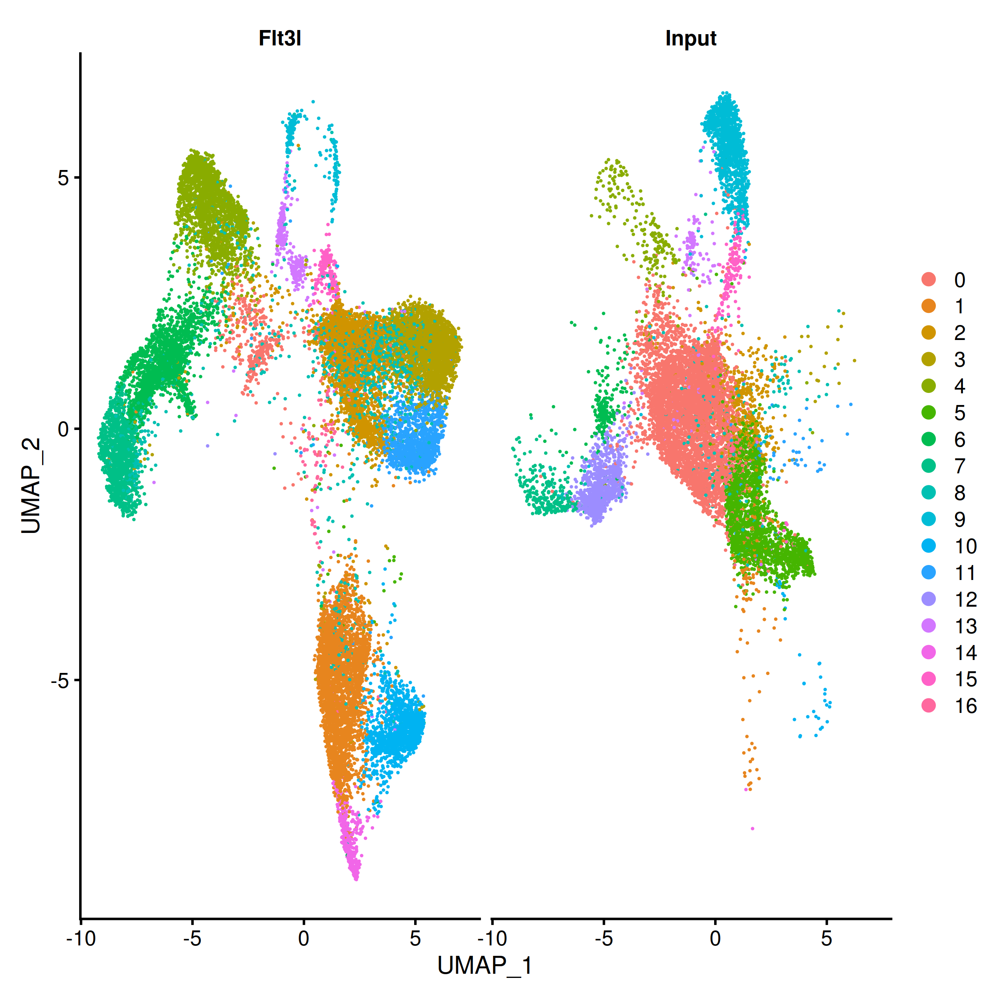

In [18]:
options(repr.plot.width = 8, repr.plot.height = 8, repr.plot.res = 300)
DimPlot(object = se, split.by = 'orig.ident', )
